In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from h5py import File
import warnings
warnings.filterwarnings('ignore')
import ants
from glob import glob

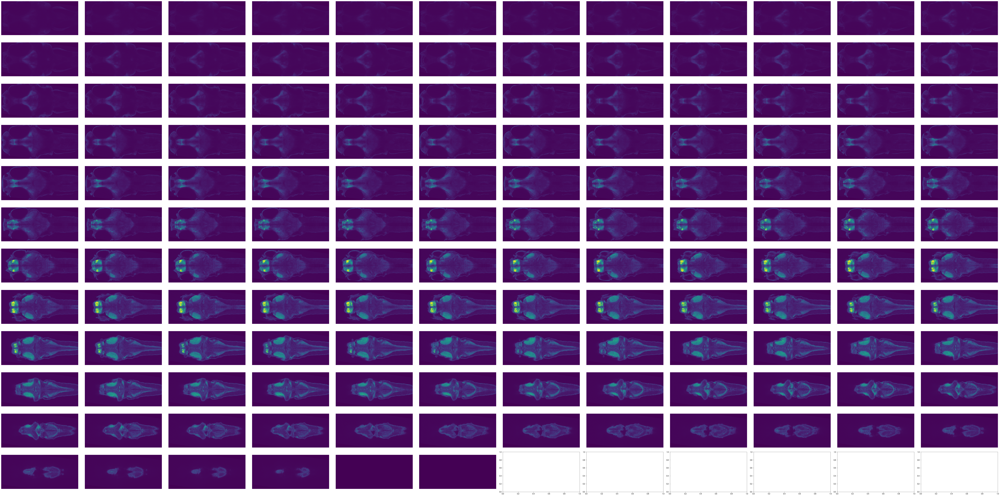

In [4]:
zbrain_img = ants.image_read('depreciated/zbrain_ref.nrrd')
zbrain_statck = zbrain_img.numpy()
_, _, nz = zbrain_statck.shape
m = np.ceil(np.sqrt(nz)).astype(int)

vmax = zbrain_statck.max()*.9
vmin = zbrain_statck.min()*2
fig, ax = plt.subplots(m, m, figsize=(80, 40))
ax = ax.flatten()
for n in range(nz):
    ax[n].imshow(zbrain_statck[:, :, n], vmax=vmax, vmin=vmin)
    ax[n].set_axis_off()
plt.tight_layout()
plt.show()

### Functional brain

In [5]:
df = pd.read_csv('../Processing/data_list.csv')

In [6]:
row = df.iloc[0]
dat_dir = row['dat_dir'].replace('/im/', '/')
dat_dir = dat_dir.replace('/im_CM0/', '/')
dat_dir = dat_dir.replace('/im_CM1/', '/')
p_dir = dat_dir + 'processed/'
ephys_dir = dat_dir + 'ephys/'
save_root = row['save_dir']+'/'
brain_map_ = np.load(save_root+'Y_ave.npy').astype('float').squeeze()

In [7]:
row = df.iloc[36]
dat_dir = row['dat_dir'].replace('/im/', '/')
dat_dir = dat_dir.replace('/im_CM0/', '/')
dat_dir = dat_dir.replace('/im_CM1/', '/')
p_dir = dat_dir + 'processed/'
ephys_dir = dat_dir + 'ephys/'
save_root = row['save_dir']+'/'
brain_map = np.load(save_root+'Y_ave.npy').astype('float').squeeze()

In [9]:
img1 = ants.from_numpy(brain_map_)
img2 = ants.from_numpy(brain_map) #[:, :, ::-1]

In [10]:
mytx = ants.registration(fixed=img1 , moving=img2, type_of_transform='SyN' )

In [11]:
mywarpedimage = ants.apply_transforms(fixed=img1, moving=img2, transformlist=mytx['fwdtransforms'])

In [12]:
mywarpedimage_ = mywarpedimage.numpy()

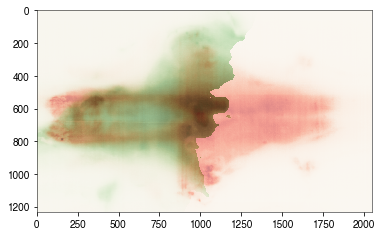

In [13]:
plt.imshow(mywarpedimage_[10], cmap=plt.cm.Greens)
plt.imshow(img1[10], alpha=0.5, cmap=plt.cm.Reds)

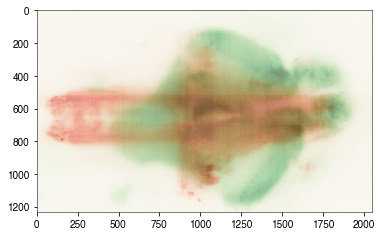

In [14]:
plt.imshow(img2[10], cmap=plt.cm.Greens)
plt.imshow(img1[10], alpha=0.5, cmap=plt.cm.Reds)

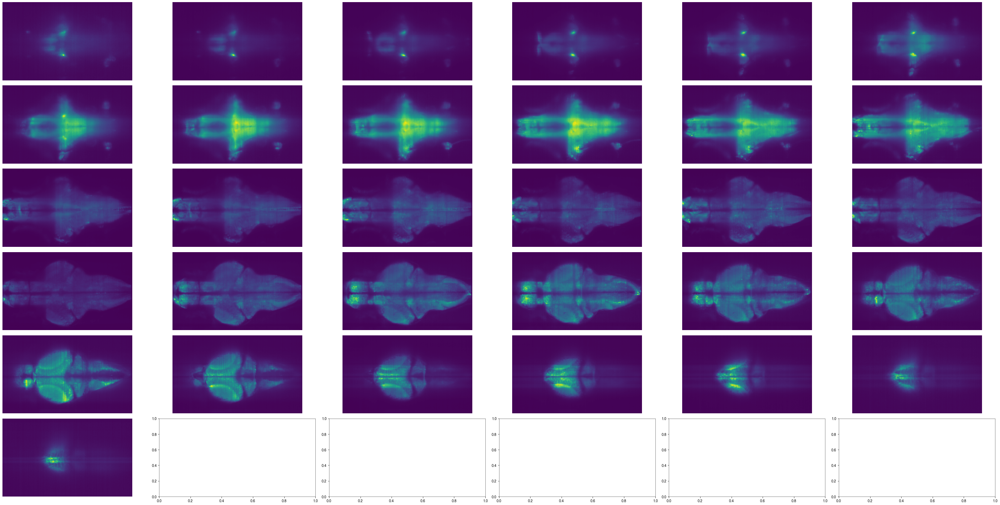

In [15]:
fig, ax = plt.subplots(6, 6, figsize=(40, 20))
ax = ax.flatten()
for n in range(31):
    ax[n].imshow(img1[n])
    ax[n].set_axis_off()
plt.tight_layout()
plt.show()

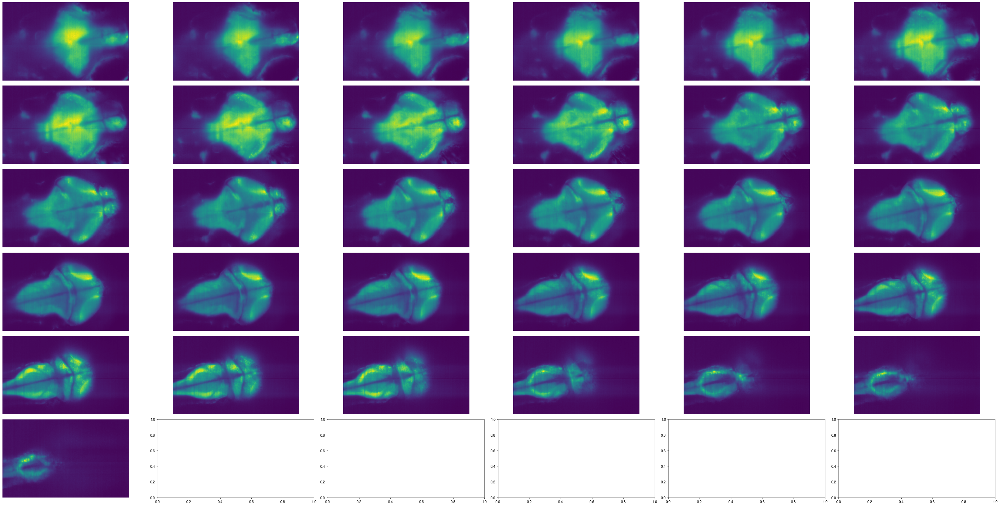

In [16]:
fig, ax = plt.subplots(6, 6, figsize=(40, 20))
ax = ax.flatten()
for n in range(31):
    ax[n].imshow(img2[n])
    ax[n].set_axis_off()
plt.tight_layout()
plt.show()